In [1]:
using DifferentialEquations
using Plots

In [2]:
# Initial conditions function
function initial_conditions(x, y, Lx, Ly)
    if Ly-1 <= y <= Ly
        if abs(x - (Lx ÷ 2)) < Lx / 20
            n1 = 1.0  # Type 1
            n2 = 0.0
        else
            n1 = 0.0
            n2 = 1.0  # Type 2
        end
    else
        n1 = 0.0
        n2 = 0.0
    end
    return n1, n2
end

# Laplacian function
function laplacian(u, dx, dy)
    lx = (circshift(u, (0, 1)) .- 2u .+ circshift(u, (0, -1))) / dx^2
    ly = (circshift(u, (1, 0)) .- 2u .+ circshift(u, (-1, 0))) / dy^2

    lx[:, 1] .= (u[:, 2] .- u[:, 1]) / dx^2
    lx[:, end] .= (u[:, end-1] .- u[:, end]) / dx^2
    ly[1, :] .= (u[2, :] .- u[1, :]) / dy^2
    ly[end, :] .= (u[end-1, :] .- u[end, :]) / dy^2

    return lx + ly
end

function laplacian_x(u, dx, dy)
    lx = (circshift(u, (0, 1)) .- 2u .+ circshift(u, (0, -1))) / dx^2

    lx[:, 1] .= (u[:, 2] .- u[:, 1]) / dx^2
    lx[:, end] .= (u[:, end-1] .- u[:, end]) / dx^2

    return lx
end

function laplacian_y(u, dx, dy)
    ly = (circshift(u, (1, 0)) .- 2u .+ circshift(u, (-1, 0))) / dy^2

    ly[1, :] .= (u[2, :] .- u[1, :]) / dy^2
    ly[end, :] .= (u[end-1, :] .- u[end, :]) / dy^2

    return ly
end

# Partial derivatives functions
function ∂x(u, dx)
    du = (circshift(u, (0, -1)) .- circshift(u, (0, 1))) / (2dx)
    du[:, 1] .= (u[:, 2] .- u[:, 1]) / dx
    du[:, end] .= (u[:, end] .- u[:, end-1]) / dx
    return du
end

function ∂y(u, dy)
    du = (circshift(u, (-1, 0)) .- circshift(u, (1, 0))) / (2dy)
    du[1, :] .= (u[2, :] .- u[1, :]) / dy
    du[end, :] .= (u[end, :] .- u[end-1, :]) / dy
    return du
end

# Main simulation function
function simulate_reaction_diffusion(; r1=0.15, r2=0.15, K=0.1, D=0.1, λ1x=0.4, λ1y=0.1, λ2x=0.4, λ2y=0.1, α = 3.0, 
                                     Lx=400.0, Ly=300.0, Nx=200, Ny=150, tspan=(0.0, 1430.0))

    # Grid
    x = LinRange(0, Lx, Nx)
    y = LinRange(0, Ly, Ny)
    dx = x[2] - x[1]
    dy = y[2] - y[1]

    # Reaction-diffusion system function
    function reaction_diffusion!(du, u, p, t)
        n1 = u[1, :, :]
        n2 = u[2, :, :]
        n = n1 .+ n2
        f = n1 ./ (n .+ 1e-5)

        du[1, :, :] .= r1 .* (1 .+ α .* f .+ 0.0 .* f .* (1 .- f)) .* n1 .* (1 .- n) .* (n .- K) + D .* laplacian(n1, dx, dy) + 
                       λ1x .* ∂x(n .* (1 .- n) .* ∂x(n1, dx), dx) + λ1y .* ∂y(n .* (1 .- n) .* ∂y(n1, dy), dy)
        du[2, :, :] .= r2 .* (1 .+ α .* f .+ 0.0 .* f .* (1 .- f)) .* n2 .* (1 .- n) .* (n .- K) + D .* laplacian(n2, dx, dy) + 
                       λ2x .* ∂x(n .* (1 .- n) .* ∂x(n2, dx), dx) + λ2y .* ∂y(n .* (1 .- n) .* ∂y(n2, dy), dy)
    end

    # Initialize conditions
    u0 = zeros(2, Ny, Nx)
    for i in 1:Nx
        for j in 1:Ny
            n1, n2 = initial_conditions(x[i], y[j], Lx, Ly)
            u0[1, j, i] = n1
            u0[2, j, i] = n2
        end
    end

    # PDE problem
    prob = ODEProblem(reaction_diffusion!, u0, tspan)

    # Solve
    sol = solve(prob, Tsit5(); saveat=tspan[2])

    # Return the final solution
    return sol
end

# Main simulation function
function simulate_reaction_diffusion_2(; r1=0.15, r2=0.15, K=0.1, D=0.1, λ1x=0.4, λ1y=0.1, λ2x=0.4, λ2y=0.1, α = 3.0, 
                                     Lx=400.0, Ly=300.0, Nx=200, Ny=150, tspan=(0.0, 1430.0))

    # Grid
    x = LinRange(0, Lx, Nx)
    y = LinRange(0, Ly, Ny)
    dx = x[2] - x[1]
    dy = y[2] - y[1]

    # Reaction-diffusion system function
    function reaction_diffusion!(du, u, p, t)
        n1 = u[1, :, :]
        n2 = u[2, :, :]
        n = n1 .+ n2
        f = n1 ./ (n .+ 1e-5)

        du[1, :, :] .= r1 .* (1 .+ α .* f .+ 0.0 .* f .* (1 .- f)) .* n1 .* (1 .- n) .* (n .- K) + D .* laplacian(n1, dx, dy) + 
                       λ1x .* ∂x(n1 .* ∂x(n, dx), dx) + λ1y .* ∂y(n1 .* ∂y(n, dy), dy)
        du[2, :, :] .= r2 .* (1 .+ α .* f .+ 0.0 .* f .* (1 .- f)) .* n2 .* (1 .- n) .* (n .- K) + D .* laplacian(n2, dx, dy) + 
                       λ2x .* ∂x(n1 .* ∂x(n, dx), dx) + λ2y .* ∂y(n2 .* ∂y(n, dy), dy)
    end

    # Initialize conditions
    u0 = zeros(2, Ny, Nx)
    for i in 1:Nx
        for j in 1:Ny
            n1, n2 = initial_conditions(x[i], y[j], Lx, Ly)
            u0[1, j, i] = n1
            u0[2, j, i] = n2
        end
    end

    # PDE problem
    prob = ODEProblem(reaction_diffusion!, u0, tspan)

    # Solve
    sol = solve(prob, Tsit5(); saveat=tspan[2])

    # Return the final solution
    return sol
end

function simulate_reaction_diffusion_3(; r1=0.15, r2=0.15, K=0.1, D1x=0.1, D1y=0.1, D2x=0.1, D2y=0.1, α = 3.0, 
                                     Lx=400.0, Ly=300.0, Nx=200, Ny=150, tspan=(0.0, 1430.0))

    # Grid
    x = LinRange(0, Lx, Nx)
    y = LinRange(0, Ly, Ny)
    dx = x[2] - x[1]
    dy = y[2] - y[1]

    # Reaction-diffusion system function
    function reaction_diffusion!(du, u, p, t)
        n1 = u[1, :, :]
        n2 = u[2, :, :]
        n = n1 .+ n2
        f = n1 ./ (n .+ 1e-5)

        du[1, :, :] .= r1 .* (1 .+ α .* f .+ 0.0 .* f .* (1 .- f)) .* n1 .* (1 .- n) .* (n .- K) + D1x .* laplacian_x(n1, dx, dy) + D1y .* laplacian_y(n1, dx, dy) 
        du[2, :, :] .= r2 .* (1 .+ α .* f .+ 0.0 .* f .* (1 .- f)) .* n2 .* (1 .- n) .* (n .- K) + D2x .* laplacian_x(n2, dx, dy) + D2y .* laplacian_y(n2, dx, dy)
    end

    # Initialize conditions
    u0 = zeros(2, Ny, Nx)
    for i in 1:Nx
        for j in 1:Ny
            n1, n2 = initial_conditions(x[i], y[j], Lx, Ly)
            u0[1, j, i] = n1
            u0[2, j, i] = n2
        end
    end

    # PDE problem
    prob = ODEProblem(reaction_diffusion!, u0, tspan)

    # Solve
    sol = solve(prob, Tsit5(); saveat=tspan[2])

    # Return the final solution
    return sol
end


simulate_reaction_diffusion_3 (generic function with 1 method)

In [39]:
final_solution = simulate_reaction_diffusion(λ1x=0.2, α=1.8, r1=0.15, tspan=(0.0, 2500.0));

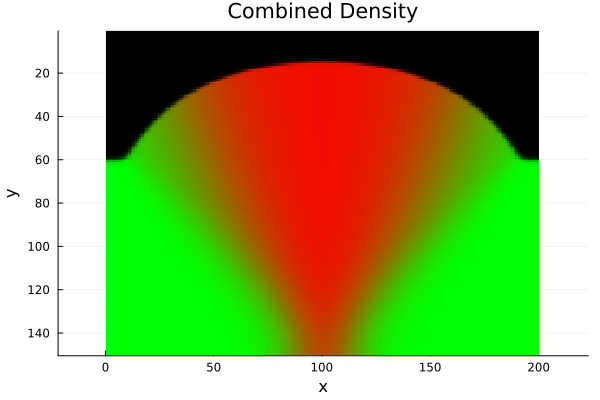

In [40]:
using Colors
sol = final_solution
# Calculate the fraction of type 1
f1 = sol[1, :, :, end] ./ (sol[1, :, :, end] .+ sol[2, :, :, end] .+ 1e-10)  # Add a small value to avoid division by zero

# Calculate the total density
total_density = sol[1, :, :, end] .+ sol[2, :, :, end]

# Create the colormap
function create_colormap(f1, total_density)
    colormap = [RGB(f1[i, j], 1-f1[i, j], 0) * total_density[i, j] for i in 1:size(f1, 1), j in 1:size(f1, 2)]
    return colormap
end

# Generate the colormap
colormap = create_colormap(f1, total_density)

# Plot the heatmap
heatmap(colormap, title="Combined Density", xlabel="x", ylabel="y", color=:auto)



First, lets do a sweep over lambda1x and lambda2x to make see what morphologies we should get.}

 10.907151 seconds (3.09 M allocations: 32.459 GiB, 9.61% gc time, 26.72% compilation time)
  6.601255 seconds (476.10 k allocations: 32.209 GiB, 11.51% gc time)
  7.254212 seconds (481.86 k allocations: 32.599 GiB, 11.06% gc time)
  6.957119 seconds (490.50 k allocations: 33.183 GiB, 11.36% gc time)
  7.131916 seconds (490.50 k allocations: 33.183 GiB, 11.80% gc time)
  7.403492 seconds (502.02 k allocations: 33.963 GiB, 11.68% gc time)
  7.224255 seconds (478.98 k allocations: 32.404 GiB, 12.46% gc time)
  7.205216 seconds (476.10 k allocations: 32.209 GiB, 11.69% gc time)
  6.502336 seconds (483.30 k allocations: 32.696 GiB, 11.38% gc time)
  7.417538 seconds (490.50 k allocations: 33.183 GiB, 11.77% gc time)
  6.720040 seconds (473.22 k allocations: 32.014 GiB, 12.00% gc time)
  7.609703 seconds (496.26 k allocations: 33.573 GiB, 11.97% gc time)
  6.593052 seconds (476.10 k allocations: 32.209 GiB, 11.32% gc time)
  6.921750 seconds (486.18 k allocations: 32.891 GiB, 11.60% gc time

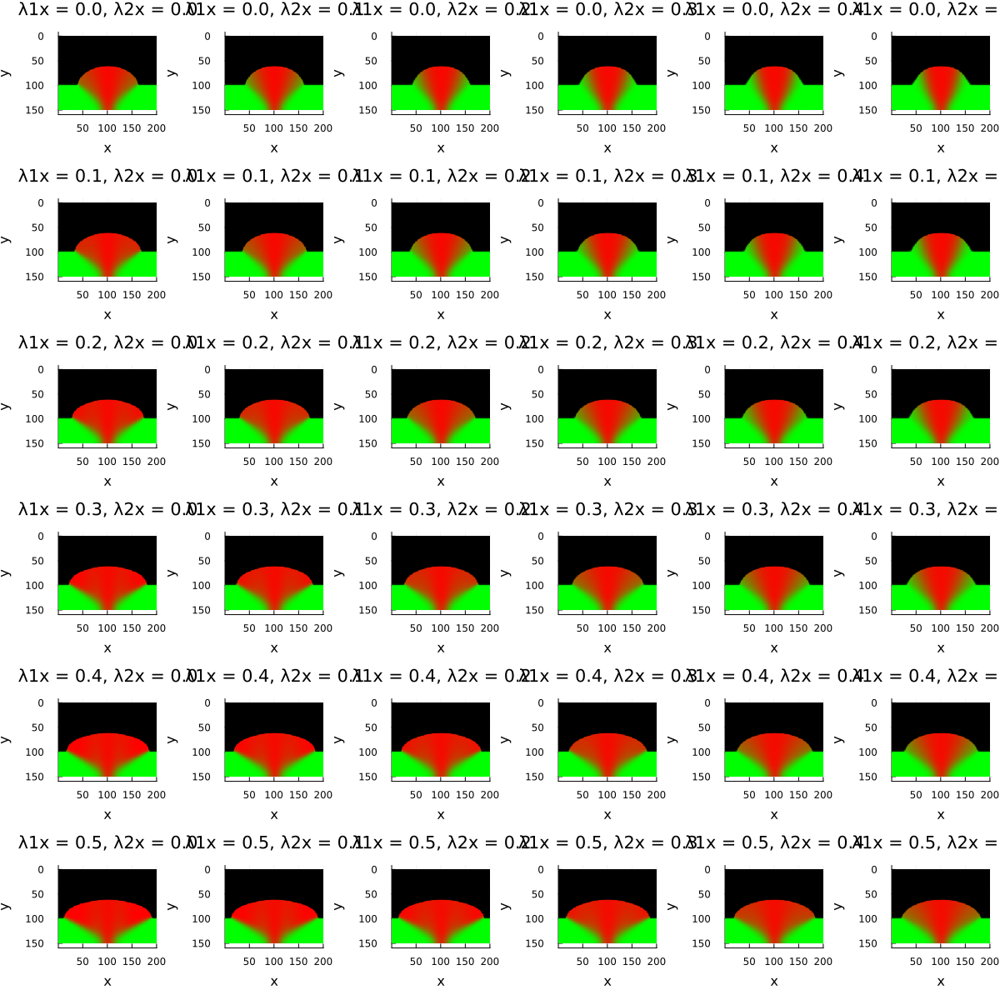

In [5]:
using Colors
using Plots

# Define the lambda ranges to loop over
lambda1x_vals = 0.0:0.1:0.5  # Modify range as needed
lambda2x_vals = 0.0:0.1:0.5  # Modify range as needed

# Storage for final density plots
plots = []

# Loop through lambda1x and lambda2x
for λ1x in lambda1x_vals
    for λ2x in lambda2x_vals
        # Run the simulation for the current λ1x and λ2x pair
        @time sol = simulate_reaction_diffusion(λ1x=λ1x, λ2x=λ2x)

        # Calculate the fraction of type 1
        f1 = sol[1, :, :, end] ./ (sol[1, :, :, end] .+ sol[2, :, :, end] .+ 1e-10)  # Avoid division by zero
        
        # Calculate the total density
        total_density = sol[1, :, :, end] .+ sol[2, :, :, end]

        # Create the colormap
        colormap = create_colormap(f1, total_density)

        # Generate the heatmap for this pair of λ1x and λ2x
        p = heatmap(colormap, title="λ1x = $λ1x, λ2x = $λ2x", xlabel="x", ylabel="y", color=:auto)

        # Store the plot in the array
        push!(plots, p)
    end
end

# Display the grid of plots
plot(plots..., layout=(length(lambda1x_vals), length(lambda2x_vals)), size=(1200, 1200))


Are the results robust if we do a different nonlinear diffusion? 

 14.026226 seconds (3.03 M allocations: 34.014 GiB, 10.80% gc time, 24.19% compilation time)
  8.627740 seconds (527.94 k allocations: 35.717 GiB, 12.51% gc time)
 26.031458 seconds (1.55 M allocations: 105.183 GiB, 12.41% gc time)
 62.679922 seconds (3.77 M allocations: 254.931 GiB, 12.28% gc time)
 85.582003 seconds (5.05 M allocations: 341.642 GiB, 12.69% gc time)
 99.071152 seconds (6.05 M allocations: 409.258 GiB, 12.70% gc time)
  8.667191 seconds (504.90 k allocations: 34.158 GiB, 12.92% gc time)
  8.872600 seconds (538.02 k allocations: 36.399 GiB, 12.74% gc time)
 20.269885 seconds (1.21 M allocations: 81.995 GiB, 12.96% gc time)
 67.639484 seconds (4.07 M allocations: 275.586 GiB, 12.96% gc time)
 91.715793 seconds (5.36 M allocations: 362.687 GiB, 13.21% gc time)
106.365386 seconds (6.36 M allocations: 430.400 GiB, 13.46% gc time)
  8.808222 seconds (490.50 k allocations: 33.183 GiB, 13.64% gc time)
  9.259320 seconds (543.78 k allocations: 36.788 GiB, 13.73% gc time)
 11.47

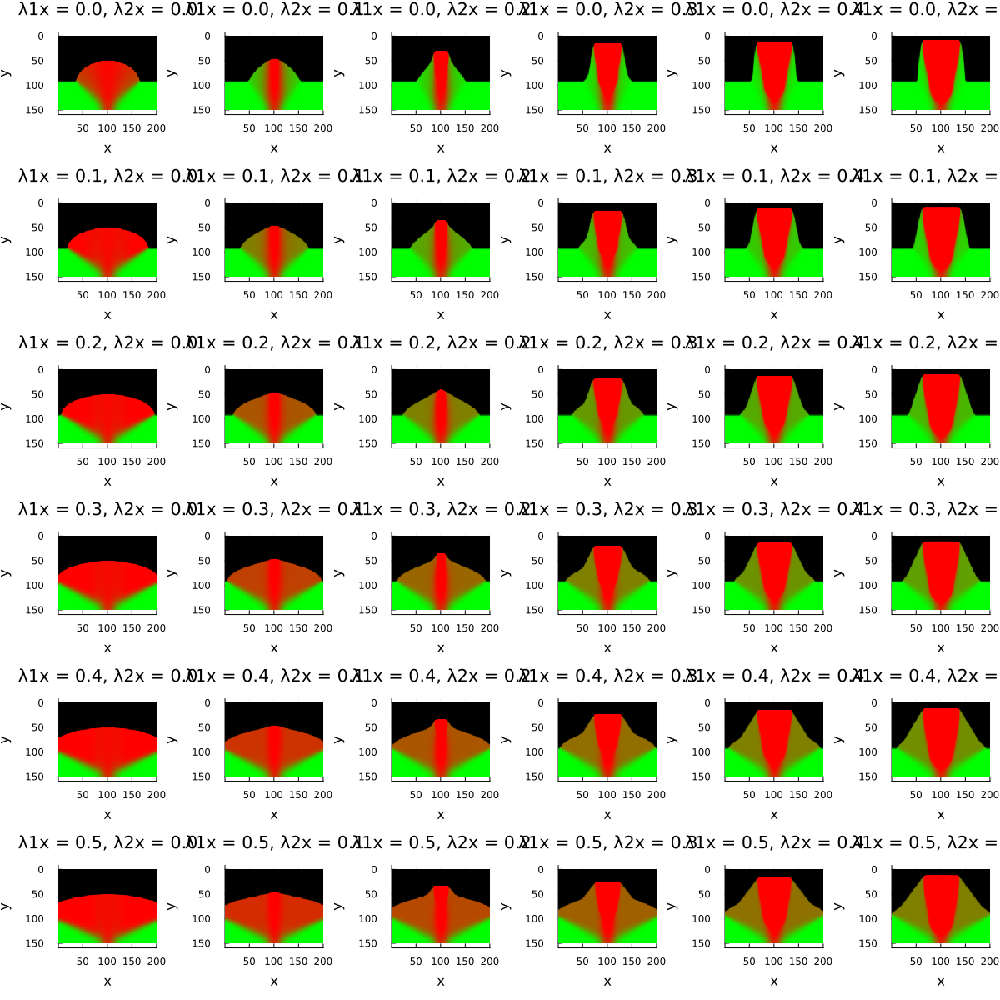

In [6]:
using Colors
using Plots

# Define the lambda ranges to loop over
lambda1x_vals = 0.0:0.1:0.5  # Modify range as needed
lambda2x_vals = 0.0:0.1:0.5  # Modify range as needed

# Storage for final density plots
plots = []

# Loop through lambda1x and lambda2x
for λ1x in lambda1x_vals
    for λ2x in lambda2x_vals
        # Run the simulation for the current λ1x and λ2x pair
        @time sol = simulate_reaction_diffusion_2(λ1x=λ1x, λ2x=λ2x)

        # Calculate the fraction of type 1
        f1 = sol[1, :, :, end] ./ (sol[1, :, :, end] .+ sol[2, :, :, end] .+ 1e-10)  # Avoid division by zero
        
        # Calculate the total density
        total_density = sol[1, :, :, end] .+ sol[2, :, :, end]

        # Create the colormap
        colormap = create_colormap(f1, total_density)

        # Generate the heatmap for this pair of λ1x and λ2x
        p = heatmap(colormap, title="λ1x = $λ1x, λ2x = $λ2x", xlabel="x", ylabel="y", color=:auto)

        # Store the plot in the array
        push!(plots, p)
    end
end

# Display the grid of plots
plot(plots..., layout=(length(lambda1x_vals), length(lambda2x_vals)), size=(1200, 1200))


  6.231443 seconds (181.33 k allocations: 13.598 GiB, 17.00% gc time)
  6.422618 seconds (187.09 k allocations: 14.030 GiB, 16.15% gc time)
  7.405958 seconds (189.97 k allocations: 14.246 GiB, 15.63% gc time)
  5.697075 seconds (188.25 k allocations: 14.116 GiB, 17.99% gc time)
  5.910026 seconds (186.52 k allocations: 13.986 GiB, 17.53% gc time)
  7.555266 seconds (200.92 k allocations: 15.067 GiB, 15.89% gc time)
  6.761921 seconds (211.29 k allocations: 15.844 GiB, 16.79% gc time)
  6.788041 seconds (191.13 k allocations: 14.332 GiB, 17.33% gc time)
  6.797901 seconds (194.01 k allocations: 14.548 GiB, 17.00% gc time)
  8.088228 seconds (192.85 k allocations: 14.462 GiB, 17.23% gc time)
  7.744551 seconds (198.61 k allocations: 14.894 GiB, 17.23% gc time)
  8.266739 seconds (208.98 k allocations: 15.672 GiB, 17.03% gc time)
  9.118685 seconds (230.29 k allocations: 17.270 GiB, 16.97% gc time)
  8.165049 seconds (206.10 k allocations: 15.456 GiB, 18.08% gc time)
  7.430550 seconds (

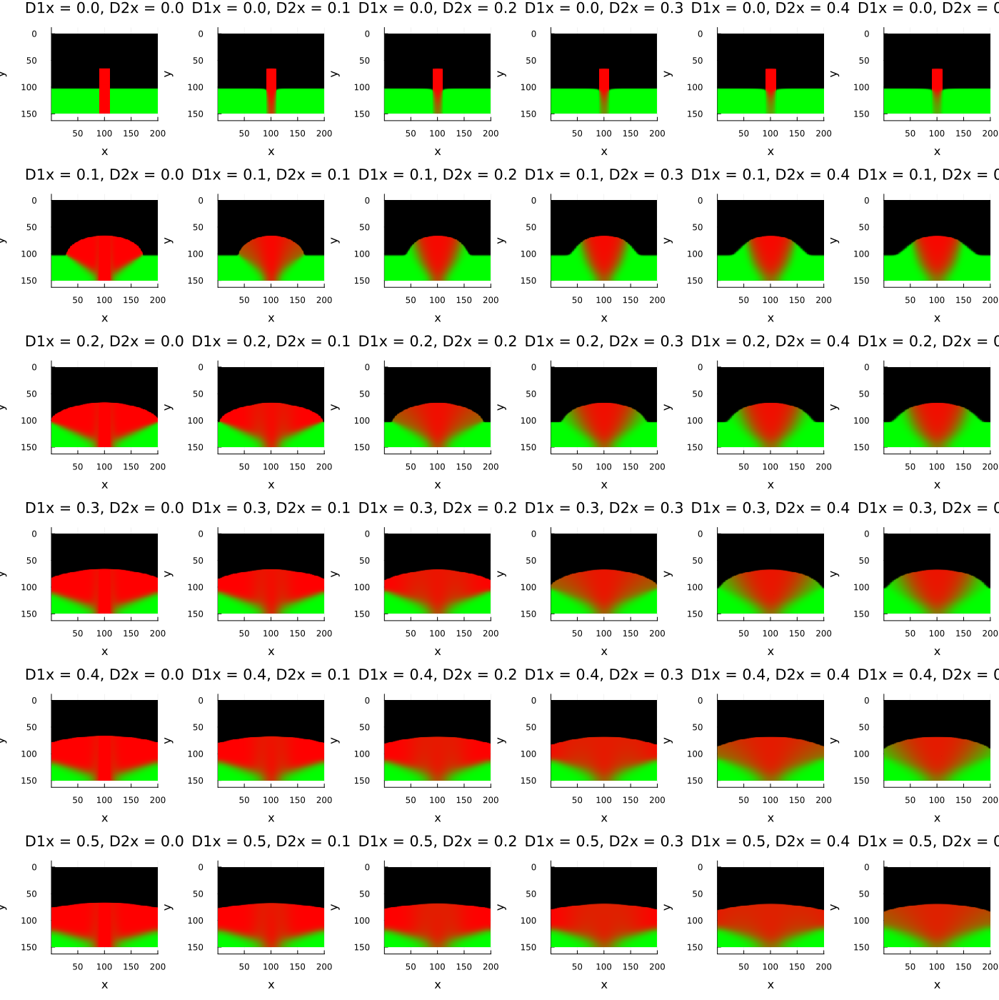

In [8]:
using Colors
using Plots

# Define the lambda ranges to loop over
lambda1x_vals = 0.0:0.1:0.5  # Modify range as needed
lambda2x_vals = 0.0:0.1:0.5  # Modify range as needed

# Storage for final density plots
plots = []

# Loop through lambda1x and lambda2x
for λ1x in lambda1x_vals
    for λ2x in lambda2x_vals
        # Run the simulation for the current λ1x and λ2x pair
        @time sol = simulate_reaction_diffusion_3(D1x=λ1x, D2x=λ2x)

        # Calculate the fraction of type 1
        f1 = sol[1, :, :, end] ./ (sol[1, :, :, end] .+ sol[2, :, :, end] .+ 1e-10)  # Avoid division by zero
        
        # Calculate the total density
        total_density = sol[1, :, :, end] .+ sol[2, :, :, end]

        # Create the colormap
        colormap = create_colormap(f1, total_density)

        # Generate the heatmap for this pair of λ1x and λ2x
        p = heatmap(colormap, title="D1x = $λ1x, D2x = $λ2x", xlabel="x", ylabel="y", color=:auto)

        # Store the plot in the array
        push!(plots, p)
    end
end

# Display the grid of plots
plot(plots..., layout=(length(lambda1x_vals), length(lambda2x_vals)), size=(1400, 1400))


What if there is no alpha? 

  2.127434 seconds (63.18 k allocations: 4.438 GiB, 19.65% gc time, 0.69% compilation time)
  2.930850 seconds (82.84 k allocations: 6.209 GiB, 17.81% gc time)
  4.012855 seconds (108.76 k allocations: 8.154 GiB, 18.39% gc time)
  4.177146 seconds (131.80 k allocations: 9.882 GiB, 17.67% gc time)
  5.331500 seconds (157.14 k allocations: 11.783 GiB, 18.48% gc time)
  6.484379 seconds (179.61 k allocations: 13.468 GiB, 17.40% gc time)
  2.788105 seconds (82.84 k allocations: 6.209 GiB, 17.14% gc time)
  2.999702 seconds (82.26 k allocations: 6.166 GiB, 17.94% gc time)
  3.880090 seconds (105.88 k allocations: 7.937 GiB, 17.55% gc time)
  4.329858 seconds (130.07 k allocations: 9.752 GiB, 17.62% gc time)
  5.809956 seconds (153.69 k allocations: 11.524 GiB, 17.60% gc time)
  6.565425 seconds (176.73 k allocations: 13.252 GiB, 18.50% gc time)
  3.777746 seconds (108.76 k allocations: 8.154 GiB, 17.91% gc time)
  3.683537 seconds (104.73 k allocations: 7.851 GiB, 17.79% gc time)
  3.920463

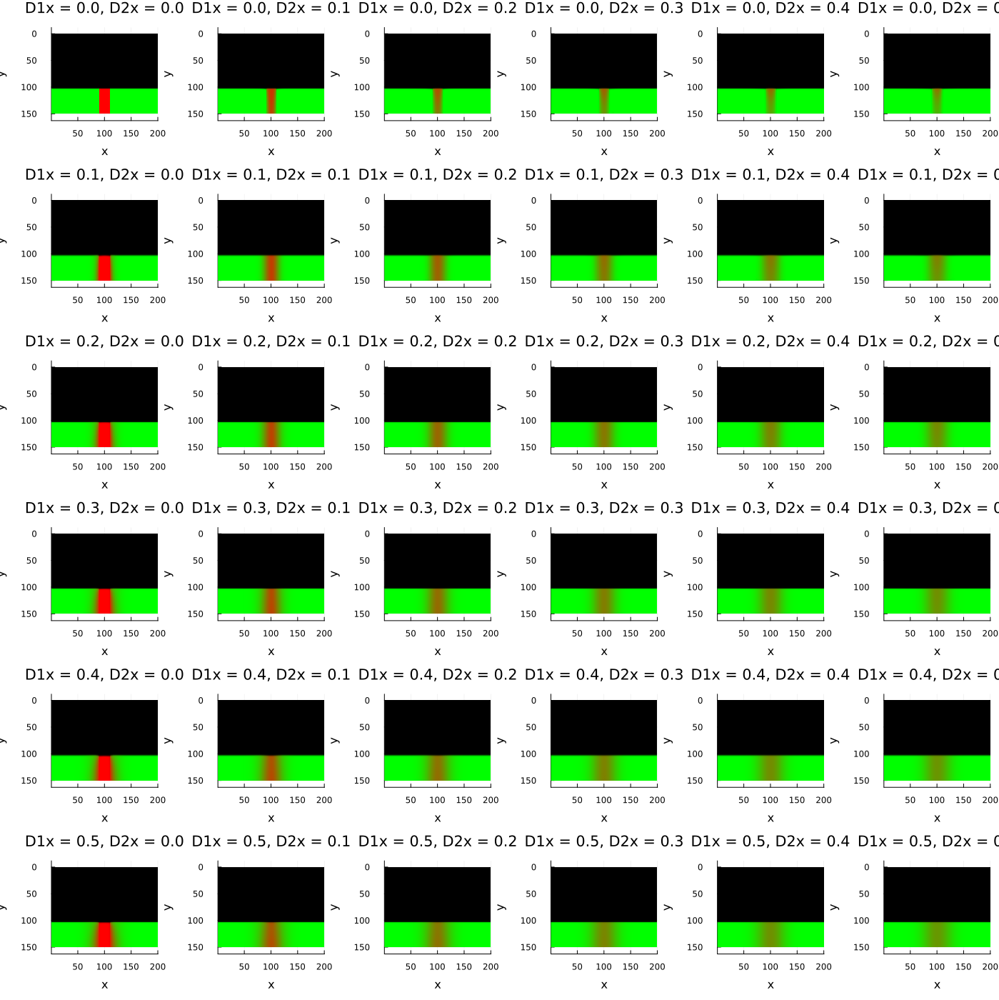

In [9]:
using Colors
using Plots

# Define the lambda ranges to loop over
lambda1x_vals = 0.0:0.1:0.5  # Modify range as needed
lambda2x_vals = 0.0:0.1:0.5  # Modify range as needed

# Storage for final density plots
plots = []

# Loop through lambda1x and lambda2x
for λ1x in lambda1x_vals
    for λ2x in lambda2x_vals
        # Run the simulation for the current λ1x and λ2x pair
        @time sol = simulate_reaction_diffusion_3(D1x=λ1x, D2x=λ2x, α=0.0)

        # Calculate the fraction of type 1
        f1 = sol[1, :, :, end] ./ (sol[1, :, :, end] .+ sol[2, :, :, end] .+ 1e-10)  # Avoid division by zero
        
        # Calculate the total density
        total_density = sol[1, :, :, end] .+ sol[2, :, :, end]

        # Create the colormap
        colormap = create_colormap(f1, total_density)

        # Generate the heatmap for this pair of λ1x and λ2x
        p = heatmap(colormap, title="D1x = $λ1x, D2x = $λ2x", xlabel="x", ylabel="y", color=:auto)

        # Store the plot in the array
        push!(plots, p)
    end
end

# Display the grid of plots
plot(plots..., layout=(length(lambda1x_vals), length(lambda2x_vals)), size=(1400, 1400))


Now lets look at what happens when you have a sector boundary on a sloped surface

In [19]:
# Initial conditions
function initial_conditions(x, y, Lx, Ly)
    if y - 0.4 * x > Ly * 4/9
        if abs(x - (Lx ÷ 2)) < Lx / 10
            n1 = 1.0  # Type 1
            n2 = 0.0
        else
            n1 = 0.0
            n2 = 1.0  # Type 2
        end
    else
        n1 = 0.0
        n2 = 0.0
    end
    return n1, n2
end
# Laplacian function
function laplacian(u, dx, dy)
    lx = (circshift(u, (0, 1)) .- 2u .+ circshift(u, (0, -1))) / dx^2
    ly = (circshift(u, (1, 0)) .- 2u .+ circshift(u, (-1, 0))) / dy^2

    lx[:, 1] .= (u[:, 2] .- u[:, 1]) / dx^2
    lx[:, end] .= (u[:, end-1] .- u[:, end]) / dx^2
    ly[1, :] .= (u[2, :] .- u[1, :]) / dy^2
    ly[end, :] .= (u[end-1, :] .- u[end, :]) / dy^2

    return lx + ly
end

function laplacian_x(u, dx, dy)
    lx = (circshift(u, (0, 1)) .- 2u .+ circshift(u, (0, -1))) / dx^2

    lx[:, 1] .= (u[:, 2] .- u[:, 1]) / dx^2
    lx[:, end] .= (u[:, end-1] .- u[:, end]) / dx^2

    return lx
end

function laplacian_y(u, dx, dy)
    ly = (circshift(u, (1, 0)) .- 2u .+ circshift(u, (-1, 0))) / dy^2

    ly[1, :] .= (u[2, :] .- u[1, :]) / dy^2
    ly[end, :] .= (u[end-1, :] .- u[end, :]) / dy^2

    return ly
end

# Partial derivatives functions
function ∂x(u, dx)
    du = (circshift(u, (0, -1)) .- circshift(u, (0, 1))) / (2dx)
    du[:, 1] .= (u[:, 2] .- u[:, 1]) / dx
    du[:, end] .= (u[:, end] .- u[:, end-1]) / dx
    return du
end

function ∂y(u, dy)
    du = (circshift(u, (-1, 0)) .- circshift(u, (1, 0))) / (2dy)
    du[1, :] .= (u[2, :] .- u[1, :]) / dy
    du[end, :] .= (u[end, :] .- u[end-1, :]) / dy
    return du
end

# Main simulation function
function simulate_reaction_diffusion(; r1=0.15, r2=0.15, K=0.1, D=0.1, λ1x=0.4, λ1y=0.1, λ2x=0.4, λ2y=0.1, α = 3.0, 
                                     Lx=400.0, Ly=300.0, Nx=200, Ny=150, tspan=(0.0, 1430.0))

    # Grid
    x = LinRange(0, Lx, Nx)
    y = LinRange(0, Ly, Ny)
    dx = x[2] - x[1]
    dy = y[2] - y[1]

    # Reaction-diffusion system function
    function reaction_diffusion!(du, u, p, t)
        n1 = u[1, :, :]
        n2 = u[2, :, :]
        n = n1 .+ n2
        f = n1 ./ (n .+ 1e-5)

        du[1, :, :] .= r1 .* (1 .+ α .* f .+ 0.0 .* f .* (1 .- f)) .* n1 .* (1 .- n) .* (n .- K) + D .* laplacian(n1, dx, dy) + 
                       λ1x .* ∂x(n .* (1 .- n) .* ∂x(n1, dx), dx) + λ1y .* ∂y(n .* (1 .- n) .* ∂y(n1, dy), dy)
        du[2, :, :] .= r2 .* (1 .+ α .* f .+ 0.0 .* f .* (1 .- f)) .* n2 .* (1 .- n) .* (n .- K) + D .* laplacian(n2, dx, dy) + 
                       λ2x .* ∂x(n .* (1 .- n) .* ∂x(n2, dx), dx) + λ2y .* ∂y(n .* (1 .- n) .* ∂y(n2, dy), dy)
    end

    # Initialize conditions
    u0 = zeros(2, Ny, Nx)
    for i in 1:Nx
        for j in 1:Ny
            n1, n2 = initial_conditions(x[i], y[j], Lx, Ly)
            u0[1, j, i] = n1
            u0[2, j, i] = n2
        end
    end

    # PDE problem
    prob = ODEProblem(reaction_diffusion!, u0, tspan)

    # Solve
    sol = solve(prob, Tsit5(); saveat=tspan[2])

    # Return the final solution
    return sol
end

# Main simulation function
function simulate_reaction_diffusion_2(; r1=0.15, r2=0.15, K=0.1, D=0.1, λ1x=0.4, λ1y=0.1, λ2x=0.4, λ2y=0.1, α = 3.0, 
                                     Lx=400.0, Ly=300.0, Nx=200, Ny=150, tspan=(0.0, 1430.0))

    # Grid
    x = LinRange(0, Lx, Nx)
    y = LinRange(0, Ly, Ny)
    dx = x[2] - x[1]
    dy = y[2] - y[1]

    # Reaction-diffusion system function
    function reaction_diffusion!(du, u, p, t)
        n1 = u[1, :, :]
        n2 = u[2, :, :]
        n = n1 .+ n2
        f = n1 ./ (n .+ 1e-5)

        du[1, :, :] .= r1 .* (1 .+ α .* f .+ 0.0 .* f .* (1 .- f)) .* n1 .* (1 .- n) .* (n .- K) + D .* laplacian(n1, dx, dy) + 
                       λ1x .* ∂x(n1 .* ∂x(n, dx), dx) + λ1y .* ∂y(n1 .* ∂y(n, dy), dy)
        du[2, :, :] .= r2 .* (1 .+ α .* f .+ 0.0 .* f .* (1 .- f)) .* n2 .* (1 .- n) .* (n .- K) + D .* laplacian(n2, dx, dy) + 
                       λ2x .* ∂x(n1 .* ∂x(n, dx), dx) + λ2y .* ∂y(n2 .* ∂y(n, dy), dy)
    end

    # Initialize conditions
    u0 = zeros(2, Ny, Nx)
    for i in 1:Nx
        for j in 1:Ny
            n1, n2 = initial_conditions(x[i], y[j], Lx, Ly)
            u0[1, j, i] = n1
            u0[2, j, i] = n2
        end
    end

    # PDE problem
    prob = ODEProblem(reaction_diffusion!, u0, tspan)

    # Solve
    sol = solve(prob, Tsit5(); saveat=tspan[2])

    # Return the final solution
    return sol
end

function simulate_reaction_diffusion_3(; r1=0.15, r2=0.15, K=0.1, D1x=0.1, D1y=0.1, D2x=0.1, D2y=0.1, α = 3.0, 
                                     Lx=400.0, Ly=300.0, Nx=200, Ny=150, tspan=(0.0, 1430.0))

    # Grid
    x = LinRange(0, Lx, Nx)
    y = LinRange(0, Ly, Ny)
    dx = x[2] - x[1]
    dy = y[2] - y[1]

    # Reaction-diffusion system function
    function reaction_diffusion!(du, u, p, t)
        n1 = u[1, :, :]
        n2 = u[2, :, :]
        n = n1 .+ n2
        f = n1 ./ (n .+ 1e-5)

        du[1, :, :] .= r1 .* (1 .+ α .* f .+ 0.0 .* f .* (1 .- f)) .* n1 .* (1 .- n) .* (n .- K) + D1x .* laplacian_x(n1, dx, dy) + D1y .* laplacian_y(n1, dx, dy) 
        du[2, :, :] .= r2 .* (1 .+ α .* f .+ 0.0 .* f .* (1 .- f)) .* n2 .* (1 .- n) .* (n .- K) + D2x .* laplacian_x(n2, dx, dy) + D2y .* laplacian_y(n2, dx, dy)
    end

    # Initialize conditions
    u0 = zeros(2, Ny, Nx)
    for i in 1:Nx
        for j in 1:Ny
            n1, n2 = initial_conditions(x[i], y[j], Lx, Ly)
            u0[1, j, i] = n1
            u0[2, j, i] = n2
        end
    end

    # PDE problem
    prob = ODEProblem(reaction_diffusion!, u0, tspan)

    # Solve
    sol = solve(prob, Tsit5(); saveat=tspan[2])

    # Return the final solution
    return sol
end


simulate_reaction_diffusion_3 (generic function with 1 method)

  4.719851 seconds (2.70 M allocations: 4.814 GiB, 10.29% gc time, 52.33% compilation time)
  3.242683 seconds (88.02 k allocations: 6.598 GiB, 18.46% gc time)
  4.425013 seconds (122.58 k allocations: 9.190 GiB, 19.36% gc time)
  4.785998 seconds (142.74 k allocations: 10.703 GiB, 19.31% gc time)
  5.639393 seconds (164.05 k allocations: 12.301 GiB, 19.17% gc time)
  6.784627 seconds (187.09 k allocations: 14.030 GiB, 19.39% gc time)
  3.013389 seconds (87.45 k allocations: 6.555 GiB, 19.14% gc time)
  3.013942 seconds (88.02 k allocations: 6.598 GiB, 19.78% gc time)
  4.428810 seconds (122.58 k allocations: 9.190 GiB, 19.64% gc time)
  5.089022 seconds (142.74 k allocations: 10.703 GiB, 19.69% gc time)
  5.637975 seconds (164.63 k allocations: 12.345 GiB, 19.62% gc time)
  6.855460 seconds (187.09 k allocations: 14.030 GiB, 19.51% gc time)
  4.416167 seconds (122.58 k allocations: 9.190 GiB, 19.78% gc time)
  3.916538 seconds (108.76 k allocations: 8.154 GiB, 19.88% gc time)
  4.2095

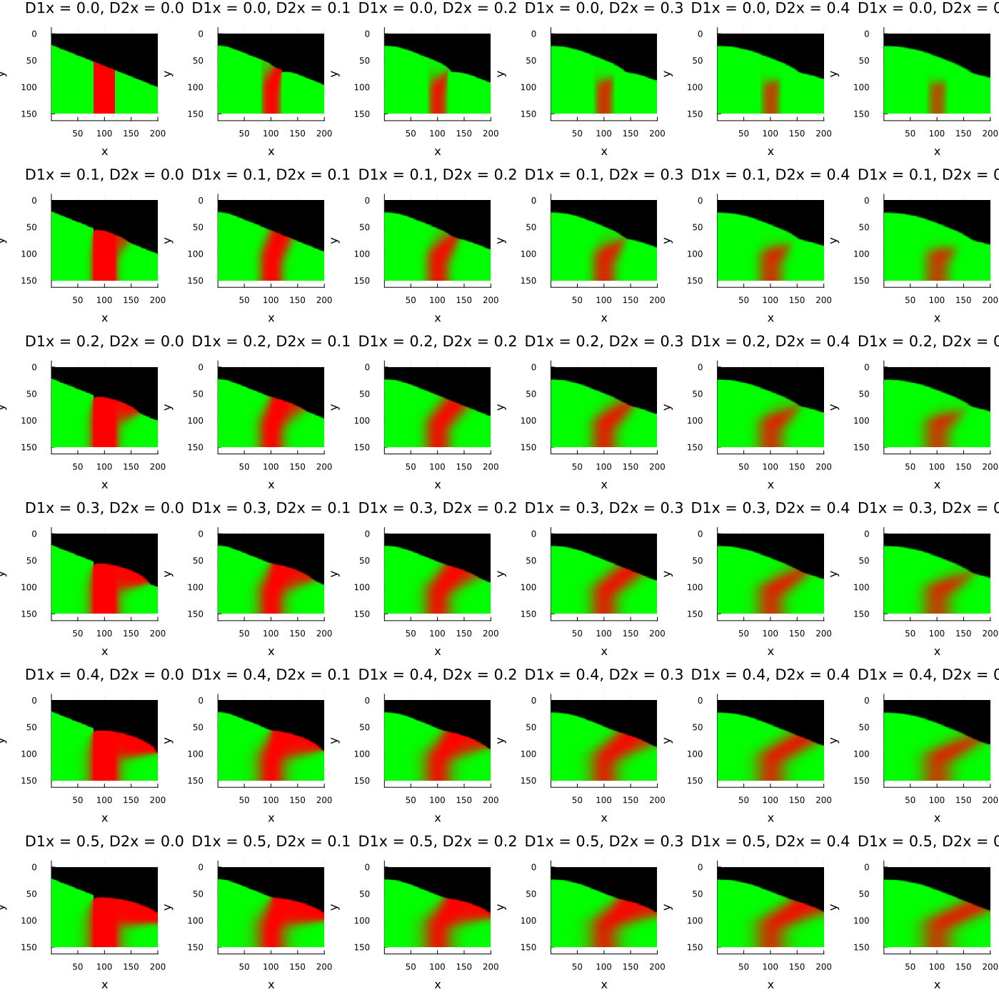

In [11]:
using Colors
using Plots

# Define the lambda ranges to loop over
lambda1x_vals = 0.0:0.1:0.5  # Modify range as needed
lambda2x_vals = 0.0:0.1:0.5  # Modify range as needed

# Storage for final density plots
plots = []

# Loop through lambda1x and lambda2x
for λ1x in lambda1x_vals
    for λ2x in lambda2x_vals
        # Run the simulation for the current λ1x and λ2x pair
        @time sol = simulate_reaction_diffusion_3(D1x=λ1x, D2x=λ2x, α=0.0)

        # Calculate the fraction of type 1
        f1 = sol[1, :, :, end] ./ (sol[1, :, :, end] .+ sol[2, :, :, end] .+ 1e-10)  # Avoid division by zero
        
        # Calculate the total density
        total_density = sol[1, :, :, end] .+ sol[2, :, :, end]

        # Create the colormap
        colormap = create_colormap(f1, total_density)

        # Generate the heatmap for this pair of λ1x and λ2x
        p = heatmap(colormap, title="D1x = $λ1x, D2x = $λ2x", xlabel="x", ylabel="y", color=:auto)

        # Store the plot in the array
        push!(plots, p)
    end
end

# Display the grid of plots
plot(plots..., layout=(length(lambda1x_vals), length(lambda2x_vals)), size=(1400, 1400))


 13.733092 seconds (2.86 M allocations: 16.523 GiB, 19.42% gc time, 23.82% compilation time)
  8.699578 seconds (189.97 k allocations: 14.246 GiB, 25.03% gc time)
  9.038313 seconds (191.70 k allocations: 14.375 GiB, 24.97% gc time)
  8.697257 seconds (185.37 k allocations: 13.900 GiB, 25.06% gc time)
  8.787311 seconds (188.82 k allocations: 14.159 GiB, 25.03% gc time)
  9.582808 seconds (204.37 k allocations: 15.326 GiB, 25.11% gc time)
  9.902725 seconds (210.13 k allocations: 15.758 GiB, 24.89% gc time)
  9.910602 seconds (210.71 k allocations: 15.801 GiB, 25.51% gc time)
  8.873940 seconds (194.01 k allocations: 14.548 GiB, 25.59% gc time)
  9.668482 seconds (208.98 k allocations: 15.672 GiB, 25.60% gc time)
  9.545390 seconds (205.53 k allocations: 15.412 GiB, 25.65% gc time)
  9.583795 seconds (212.44 k allocations: 15.931 GiB, 25.35% gc time)
 11.048664 seconds (231.45 k allocations: 17.357 GiB, 25.81% gc time)
 10.687977 seconds (223.38 k allocations: 16.752 GiB, 24.95% gc tim

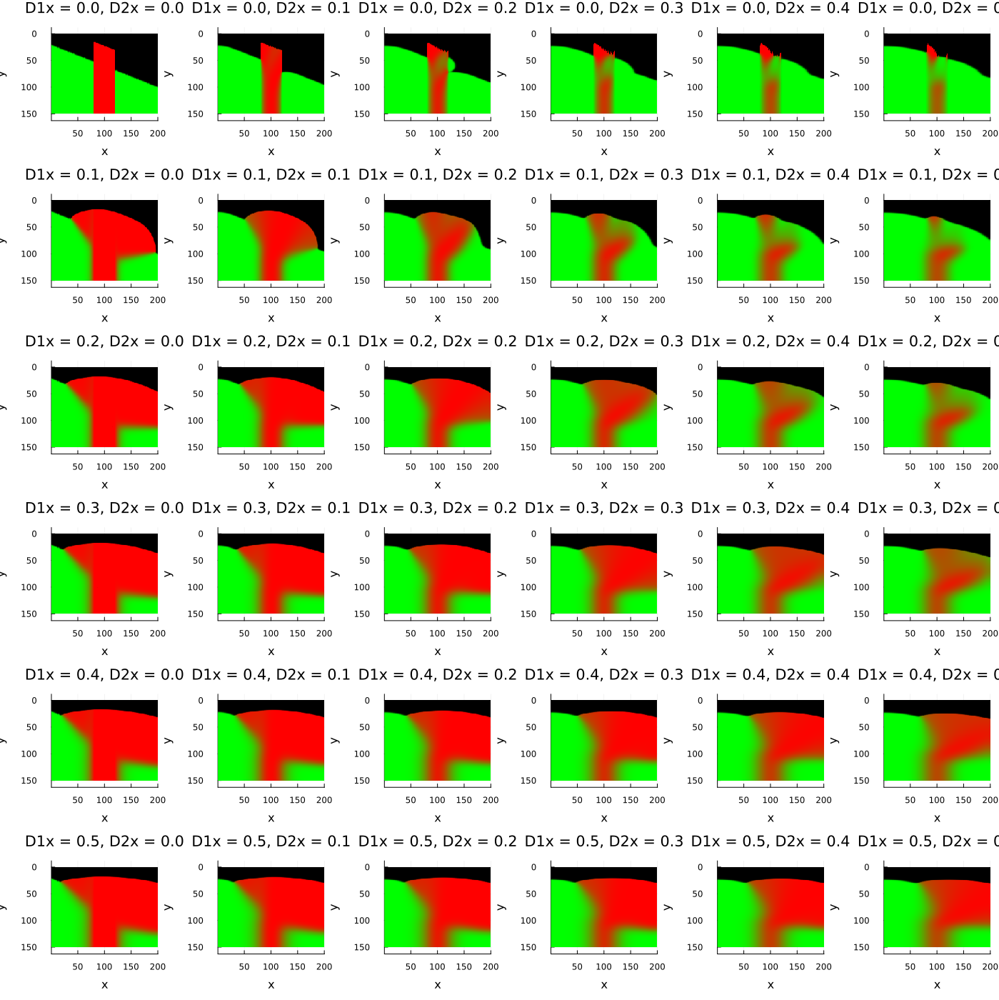

In [20]:
using Colors
using Plots

# Define the lambda ranges to loop over
lambda1x_vals = 0.0:0.1:0.5  # Modify range as needed
lambda2x_vals = 0.0:0.1:0.5  # Modify range as needed

# Storage for final density plots
plots = []

# Loop through lambda1x and lambda2x
for λ1x in lambda1x_vals
    for λ2x in lambda2x_vals
        # Run the simulation for the current λ1x and λ2x pair
        @time sol = simulate_reaction_diffusion_3(D1x=λ1x, D2x=λ2x)

        # Calculate the fraction of type 1
        f1 = sol[1, :, :, end] ./ (sol[1, :, :, end] .+ sol[2, :, :, end] .+ 1e-10)  # Avoid division by zero
        
        # Calculate the total density
        total_density = sol[1, :, :, end] .+ sol[2, :, :, end]

        # Create the colormap
        colormap = create_colormap(f1, total_density)

        # Generate the heatmap for this pair of λ1x and λ2x
        p = heatmap(colormap, title="D1x = $λ1x, D2x = $λ2x", xlabel="x", ylabel="y", color=:auto)

        # Store the plot in the array
        push!(plots, p)
    end
end

# Display the grid of plots
plot(plots..., layout=(length(lambda1x_vals), length(lambda2x_vals)), size=(1400, 1400))


Lets do some simple single strain simulations to see what colonies look like

In [17]:
# Initial conditions
function initial_conditions(x, y, Lx, Ly)
    if (x - Lx÷2)^2 + (y - Ly÷2)^2 < 100
            n1 = 0.0
            n2 = 1.0  # Type 2
    else
        n1 = 0.0
        n2 = 0.0
    end
    return n1, n2
end
# Laplacian function
function laplacian(u, dx, dy)
    lx = (circshift(u, (0, 1)) .- 2u .+ circshift(u, (0, -1))) / dx^2
    ly = (circshift(u, (1, 0)) .- 2u .+ circshift(u, (-1, 0))) / dy^2

    lx[:, 1] .= (u[:, 2] .- u[:, 1]) / dx^2
    lx[:, end] .= (u[:, end-1] .- u[:, end]) / dx^2
    ly[1, :] .= (u[2, :] .- u[1, :]) / dy^2
    ly[end, :] .= (u[end-1, :] .- u[end, :]) / dy^2

    return lx + ly
end

function laplacian_x(u, dx, dy)
    lx = (circshift(u, (0, 1)) .- 2u .+ circshift(u, (0, -1))) / dx^2

    lx[:, 1] .= (u[:, 2] .- u[:, 1]) / dx^2
    lx[:, end] .= (u[:, end-1] .- u[:, end]) / dx^2

    return lx
end

function laplacian_y(u, dx, dy)
    ly = (circshift(u, (1, 0)) .- 2u .+ circshift(u, (-1, 0))) / dy^2

    ly[1, :] .= (u[2, :] .- u[1, :]) / dy^2
    ly[end, :] .= (u[end-1, :] .- u[end, :]) / dy^2

    return ly
end

# Partial derivatives functions
function ∂x(u, dx)
    du = (circshift(u, (0, -1)) .- circshift(u, (0, 1))) / (2dx)
    du[:, 1] .= (u[:, 2] .- u[:, 1]) / dx
    du[:, end] .= (u[:, end] .- u[:, end-1]) / dx
    return du
end

function ∂y(u, dy)
    du = (circshift(u, (-1, 0)) .- circshift(u, (1, 0))) / (2dy)
    du[1, :] .= (u[2, :] .- u[1, :]) / dy
    du[end, :] .= (u[end, :] .- u[end-1, :]) / dy
    return du
end

# Main simulation function
function simulate_reaction_diffusion(; r1=0.15, r2=0.15, K=0.1, D=0.1, λ1x=0.4, λ1y=0.1, λ2x=0.4, λ2y=0.1, α = 3.0, 
                                     Lx=400.0, Ly=300.0, Nx=200, Ny=150, tspan=(0.0, 1430.0))

    # Grid
    x = LinRange(0, Lx, Nx)
    y = LinRange(0, Ly, Ny)
    dx = x[2] - x[1]
    dy = y[2] - y[1]

    # Reaction-diffusion system function
    function reaction_diffusion!(du, u, p, t)
        n1 = u[1, :, :]
        n2 = u[2, :, :]
        n = n1 .+ n2
        f = n1 ./ (n .+ 1e-5)

        du[1, :, :] .= r1 .* (1 .+ α .* f .+ 0.0 .* f .* (1 .- f)) .* n1 .* (1 .- n) .* (n .- K) + D .* laplacian(n1, dx, dy) + 
                       λ1x .* ∂x(n .* (1 .- n) .* ∂x(n1, dx), dx) + λ1y .* ∂y(n .* (1 .- n) .* ∂y(n1, dy), dy)
        du[2, :, :] .= r2 .* (1 .+ α .* f .+ 0.0 .* f .* (1 .- f)) .* n2 .* (1 .- n) .* (n .- K) + D .* laplacian(n2, dx, dy) + 
                       λ2x .* ∂x(n .* (1 .- n) .* ∂x(n2, dx), dx) + λ2y .* ∂y(n .* (1 .- n) .* ∂y(n2, dy), dy)
    end

    # Initialize conditions
    u0 = zeros(2, Ny, Nx)
    for i in 1:Nx
        for j in 1:Ny
            n1, n2 = initial_conditions(x[i], y[j], Lx, Ly)
            u0[1, j, i] = n1
            u0[2, j, i] = n2
        end
    end

    # PDE problem
    prob = ODEProblem(reaction_diffusion!, u0, tspan)

    # Solve
    sol = solve(prob, Tsit5(); saveat=tspan[2])

    # Return the final solution
    return sol
end

# Main simulation function
function simulate_reaction_diffusion_2(; r1=0.15, r2=0.15, K=0.1, D=0.1, λ1x=0.4, λ1y=0.1, λ2x=0.4, λ2y=0.1, α = 3.0, 
                                     Lx=400.0, Ly=300.0, Nx=200, Ny=150, tspan=(0.0, 1430.0))

    # Grid
    x = LinRange(0, Lx, Nx)
    y = LinRange(0, Ly, Ny)
    dx = x[2] - x[1]
    dy = y[2] - y[1]

    # Reaction-diffusion system function
    function reaction_diffusion!(du, u, p, t)
        n1 = u[1, :, :]
        n2 = u[2, :, :]
        n = n1 .+ n2
        f = n1 ./ (n .+ 1e-5)

        du[1, :, :] .= r1 .* (1 .+ α .* f .+ 0.0 .* f .* (1 .- f)) .* n1 .* (1 .- n) .* (n .- K) + D .* laplacian(n1, dx, dy) + 
                       λ1x .* ∂x(n1 .* ∂x(n, dx), dx) + λ1y .* ∂y(n1 .* ∂y(n, dy), dy)
        du[2, :, :] .= r2 .* (1 .+ α .* f .+ 0.0 .* f .* (1 .- f)) .* n2 .* (1 .- n) .* (n .- K) + D .* laplacian(n2, dx, dy) + 
                       λ2x .* ∂x(n1 .* ∂x(n, dx), dx) + λ2y .* ∂y(n2 .* ∂y(n, dy), dy)
    end

    # Initialize conditions
    u0 = zeros(2, Ny, Nx)
    for i in 1:Nx
        for j in 1:Ny
            n1, n2 = initial_conditions(x[i], y[j], Lx, Ly)
            u0[1, j, i] = n1
            u0[2, j, i] = n2
        end
    end

    # PDE problem
    prob = ODEProblem(reaction_diffusion!, u0, tspan)

    # Solve
    sol = solve(prob, Tsit5(); saveat=tspan[2])

    # Return the final solution
    return sol
end

function simulate_reaction_diffusion_3(; r1=0.15, r2=0.15, K=0.1, D1x=0.1, D1y=0.1, D2x=0.1, D2y=0.1, α = 3.0, 
                                     Lx=400.0, Ly=300.0, Nx=200, Ny=150, tspan=(0.0, 1430.0))

    # Grid
    x = LinRange(0, Lx, Nx)
    y = LinRange(0, Ly, Ny)
    dx = x[2] - x[1]
    dy = y[2] - y[1]

    # Reaction-diffusion system function
    function reaction_diffusion!(du, u, p, t)
        n1 = u[1, :, :]
        n2 = u[2, :, :]
        n = n1 .+ n2
        f = n1 ./ (n .+ 1e-5)

        du[1, :, :] .= r1 .* (1 .+ α .* f .+ 0.0 .* f .* (1 .- f)) .* n1 .* (1 .- n) .* (n .- K) + D1x .* laplacian_x(n1, dx, dy) + D1y .* laplacian_y(n1, dx, dy) 
        du[2, :, :] .= r2 .* (1 .+ α .* f .+ 0.0 .* f .* (1 .- f)) .* n2 .* (1 .- n) .* (n .- K) + D2x .* laplacian_x(n2, dx, dy) + D2y .* laplacian_y(n2, dx, dy)
    end

    # Initialize conditions
    u0 = zeros(2, Ny, Nx)
    for i in 1:Nx
        for j in 1:Ny
            n1, n2 = initial_conditions(x[i], y[j], Lx, Ly)
            u0[1, j, i] = n1
            u0[2, j, i] = n2
        end
    end

    # PDE problem
    prob = ODEProblem(reaction_diffusion!, u0, tspan)

    # Solve
    sol = solve(prob, Tsit5(); saveat=tspan[2])

    # Return the final solution
    return sol
end


simulate_reaction_diffusion_3 (generic function with 1 method)

  7.759201 seconds (7.23 M allocations: 2.338 GiB, 6.29% gc time, 83.34% compilation time)
  1.333080 seconds (32.16 k allocations: 2.407 GiB, 23.83% gc time)
  1.640008 seconds (39.64 k allocations: 2.969 GiB, 25.55% gc time)
  1.970090 seconds (48.28 k allocations: 3.617 GiB, 23.31% gc time)
  2.257569 seconds (55.77 k allocations: 4.178 GiB, 24.09% gc time)
  2.651829 seconds (63.84 k allocations: 4.783 GiB, 23.51% gc time)
  1.074319 seconds (25.24 k allocations: 1.888 GiB, 24.79% gc time)
  1.477902 seconds (32.16 k allocations: 2.407 GiB, 23.43% gc time)
  1.818477 seconds (39.64 k allocations: 2.969 GiB, 23.73% gc time)
  2.137524 seconds (48.28 k allocations: 3.617 GiB, 23.13% gc time)
  2.475734 seconds (55.77 k allocations: 4.178 GiB, 24.41% gc time)
  2.845095 seconds (63.84 k allocations: 4.783 GiB, 24.09% gc time)
  1.016485 seconds (25.24 k allocations: 1.888 GiB, 23.89% gc time)
  1.313530 seconds (32.16 k allocations: 2.407 GiB, 23.60% gc time)
  1.608235 seconds (39.64

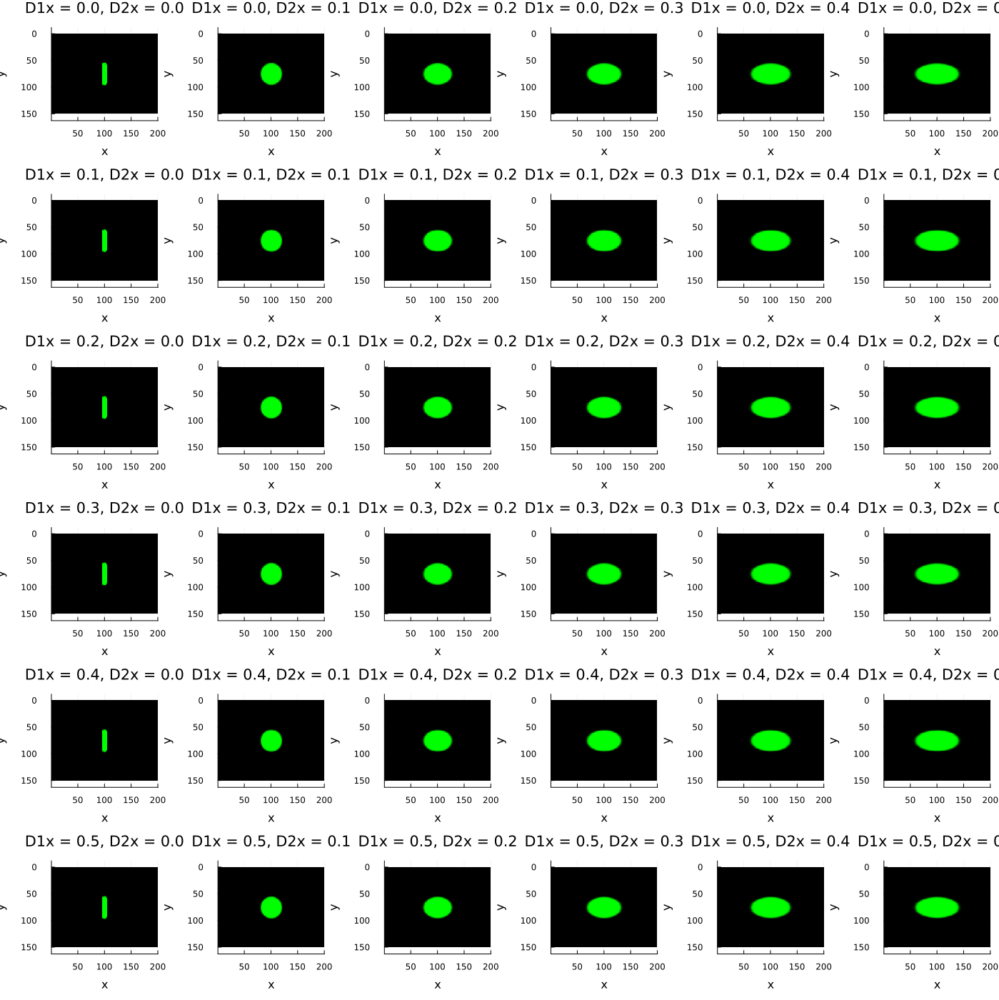

In [18]:
using Colors
using Plots

# Define the lambda ranges to loop over
lambda1x_vals = 0.0:0.1:0.5  # Modify range as needed
lambda2x_vals = 0.0:0.1:0.5  # Modify range as needed

# Storage for final density plots
plots = []

# Loop through lambda1x and lambda2x
for λ1x in lambda1x_vals
    for λ2x in lambda2x_vals
        # Run the simulation for the current λ1x and λ2x pair
        @time sol = simulate_reaction_diffusion_3(D1x=λ1x, D2x=λ2x, α=0.0, tspan=(0,500))

        # Calculate the fraction of type 1
        f1 = sol[1, :, :, end] ./ (sol[1, :, :, end] .+ sol[2, :, :, end] .+ 1e-10)  # Avoid division by zero
        
        # Calculate the total density
        total_density = sol[1, :, :, end] .+ sol[2, :, :, end]

        # Create the colormap
        colormap = create_colormap(f1, total_density)

        # Generate the heatmap for this pair of λ1x and λ2x
        p = heatmap(colormap, title="D1x = $λ1x, D2x = $λ2x", xlabel="x", ylabel="y", color=:auto)

        # Store the plot in the array
        push!(plots, p)
    end
end

# Display the grid of plots
plot(plots..., layout=(length(lambda1x_vals), length(lambda2x_vals)), size=(1400, 1400))


Stability of fronts to perturbations?

In [7]:
# Initial conditions
function initial_conditions(x, y, Lx, Ly)
    if y < 3 * sin(x)
        if abs(x - (Lx ÷ 2)) < Lx / 10
            n1 = 1.0  # Type 1
            n2 = 0.0
        else
            n1 = 0.0
            n2 = 1.0  # Type 2
        end
    else
        n1 = 0.0
        n2 = 0.0
    end
    return n1, n2
end
# Laplacian function
function laplacian(u, dx, dy)
    lx = (circshift(u, (0, 1)) .- 2u .+ circshift(u, (0, -1))) / dx^2
    ly = (circshift(u, (1, 0)) .- 2u .+ circshift(u, (-1, 0))) / dy^2

    lx[:, 1] .= (u[:, 2] .- u[:, 1]) / dx^2
    lx[:, end] .= (u[:, end-1] .- u[:, end]) / dx^2
    ly[1, :] .= (u[2, :] .- u[1, :]) / dy^2
    ly[end, :] .= (u[end-1, :] .- u[end, :]) / dy^2

    return lx + ly
end

function laplacian_x(u, dx, dy)
    lx = (circshift(u, (0, 1)) .- 2u .+ circshift(u, (0, -1))) / dx^2

    lx[:, 1] .= (u[:, 2] .- u[:, 1]) / dx^2
    lx[:, end] .= (u[:, end-1] .- u[:, end]) / dx^2

    return lx
end

function laplacian_y(u, dx, dy)
    ly = (circshift(u, (1, 0)) .- 2u .+ circshift(u, (-1, 0))) / dy^2

    ly[1, :] .= (u[2, :] .- u[1, :]) / dy^2
    ly[end, :] .= (u[end-1, :] .- u[end, :]) / dy^2

    return ly
end

# Partial derivatives functions
function ∂x(u, dx)
    du = (circshift(u, (0, -1)) .- circshift(u, (0, 1))) / (2dx)
    du[:, 1] .= (u[:, 2] .- u[:, 1]) / dx
    du[:, end] .= (u[:, end] .- u[:, end-1]) / dx
    return du
end

function ∂y(u, dy)
    du = (circshift(u, (-1, 0)) .- circshift(u, (1, 0))) / (2dy)
    du[1, :] .= (u[2, :] .- u[1, :]) / dy
    du[end, :] .= (u[end, :] .- u[end-1, :]) / dy
    return du
end

# Main simulation function
function simulate_reaction_diffusion(; r1=0.15, r2=0.15, K=0.1, D=0.1, λ1x=0.4, λ1y=0.1, λ2x=0.4, λ2y=0.1, α = 3.0, 
                                     Lx=400.0, Ly=300.0, Nx=200, Ny=150, tspan=(0.0, 1430.0))

    # Grid
    x = LinRange(0, Lx, Nx)
    y = LinRange(0, Ly, Ny)
    dx = x[2] - x[1]
    dy = y[2] - y[1]

    # Reaction-diffusion system function
    function reaction_diffusion!(du, u, p, t)
        n1 = u[1, :, :]
        n2 = u[2, :, :]
        n = n1 .+ n2
        f = n1 ./ (n .+ 1e-5)

        du[1, :, :] .= r1 .* (1 .+ α .* f .+ 0.0 .* f .* (1 .- f)) .* n1 .* (1 .- n) .* (n .- K) + D .* laplacian(n1, dx, dy) + 
                       λ1x .* ∂x(n .* (1 .- n) .* ∂x(n1, dx), dx) + λ1y .* ∂y(n .* (1 .- n) .* ∂y(n1, dy), dy)
        du[2, :, :] .= r2 .* (1 .+ α .* f .+ 0.0 .* f .* (1 .- f)) .* n2 .* (1 .- n) .* (n .- K) + D .* laplacian(n2, dx, dy) + 
                       λ2x .* ∂x(n .* (1 .- n) .* ∂x(n2, dx), dx) + λ2y .* ∂y(n .* (1 .- n) .* ∂y(n2, dy), dy)
    end

    # Initialize conditions
    u0 = zeros(2, Ny, Nx)
    for i in 1:Nx
        for j in 1:Ny
            n1, n2 = initial_conditions(x[i], y[j], Lx, Ly)
            u0[1, j, i] = n1
            u0[2, j, i] = n2
        end
    end

    # PDE problem
    prob = ODEProblem(reaction_diffusion!, u0, tspan)

    # Solve
    sol = solve(prob, Tsit5(); saveat=tspan[2])

    # Return the final solution
    return sol
end

# Main simulation function
function simulate_reaction_diffusion_2(; r1=0.15, r2=0.15, K=0.1, D=0.1, λ1x=0.4, λ1y=0.1, λ2x=0.4, λ2y=0.1, α = 3.0, 
                                     Lx=400.0, Ly=300.0, Nx=200, Ny=150, tspan=(0.0, 1430.0))

    # Grid
    x = LinRange(0, Lx, Nx)
    y = LinRange(0, Ly, Ny)
    dx = x[2] - x[1]
    dy = y[2] - y[1]

    # Reaction-diffusion system function
    function reaction_diffusion!(du, u, p, t)
        n1 = u[1, :, :]
        n2 = u[2, :, :]
        n = n1 .+ n2
        f = n1 ./ (n .+ 1e-5)

        du[1, :, :] .= r1 .* (1 .+ α .* f .+ 0.0 .* f .* (1 .- f)) .* n1 .* (1 .- n) .* (n .- K) + D .* laplacian(n1, dx, dy) + 
                       λ1x .* ∂x(n1 .* ∂x(n, dx), dx) + λ1y .* ∂y(n1 .* ∂y(n, dy), dy)
        du[2, :, :] .= r2 .* (1 .+ α .* f .+ 0.0 .* f .* (1 .- f)) .* n2 .* (1 .- n) .* (n .- K) + D .* laplacian(n2, dx, dy) + 
                       λ2x .* ∂x(n1 .* ∂x(n, dx), dx) + λ2y .* ∂y(n2 .* ∂y(n, dy), dy)
    end

    # Initialize conditions
    u0 = zeros(2, Ny, Nx)
    for i in 1:Nx
        for j in 1:Ny
            n1, n2 = initial_conditions(x[i], y[j], Lx, Ly)
            u0[1, j, i] = n1
            u0[2, j, i] = n2
        end
    end

    # PDE problem
    prob = ODEProblem(reaction_diffusion!, u0, tspan)

    # Solve
    sol = solve(prob, Tsit5(); saveat=tspan[2])

    # Return the final solution
    return sol
end

function simulate_reaction_diffusion_3(; r1=0.15, r2=0.15, K=0.1, D1x=0.1, D1y=0.1, D2x=0.1, D2y=0.1, α = 3.0, 
                                     Lx=400.0, Ly=300.0, Nx=200, Ny=150, tspan=(0.0, 1430.0))

    # Grid
    x = LinRange(0, Lx, Nx)
    y = LinRange(0, Ly, Ny)
    dx = x[2] - x[1]
    dy = y[2] - y[1]

    # Reaction-diffusion system function
    function reaction_diffusion!(du, u, p, t)
        n1 = u[1, :, :]
        n2 = u[2, :, :]
        n = n1 .+ n2
        f = n1 ./ (n .+ 1e-5)

        du[1, :, :] .= r1 .* (1 .+ α .* f .+ 0.0 .* f .* (1 .- f)) .* n1 .* (1 .- n) .* (n .- K) + D1x .* laplacian_x(n1, dx, dy) + D1y .* laplacian_y(n1, dx, dy) 
        du[2, :, :] .= r2 .* (1 .+ α .* f .+ 0.0 .* f .* (1 .- f)) .* n2 .* (1 .- n) .* (n .- K) + D2x .* laplacian_x(n2, dx, dy) + D2y .* laplacian_y(n2, dx, dy)
    end

    # Initialize conditions
    u0 = zeros(2, Ny, Nx)
    for i in 1:Nx
        for j in 1:Ny
            n1, n2 = initial_conditions(x[i], y[j], Lx, Ly)
            u0[1, j, i] = n1
            u0[2, j, i] = n2
        end
    end

    # PDE problem
    prob = ODEProblem(reaction_diffusion!, u0, tspan)

    # Solve
    sol = solve(prob, Tsit5(); saveat=tspan[2])

    # Return the final solution
    return sol
end


simulate_reaction_diffusion_3 (generic function with 1 method)

  3.968558 seconds (317.68 k allocations: 14.168 GiB, 12.44% gc time, 3.74% compilation time)
  4.291544 seconds (190.55 k allocations: 14.289 GiB, 11.48% gc time)
  4.081569 seconds (193.43 k allocations: 14.505 GiB, 11.93% gc time)
  3.896824 seconds (191.13 k allocations: 14.332 GiB, 11.81% gc time)
  3.932848 seconds (191.13 k allocations: 14.332 GiB, 12.03% gc time)
  4.342561 seconds (190.55 k allocations: 14.289 GiB, 12.28% gc time)
  4.426189 seconds (207.25 k allocations: 15.542 GiB, 12.29% gc time)
  4.367133 seconds (213.01 k allocations: 15.974 GiB, 12.16% gc time)
  4.165259 seconds (195.73 k allocations: 14.678 GiB, 11.93% gc time)
  4.693410 seconds (208.41 k allocations: 15.628 GiB, 11.94% gc time)
  4.362277 seconds (209.56 k allocations: 15.715 GiB, 12.09% gc time)
  4.440696 seconds (211.86 k allocations: 15.888 GiB, 12.45% gc time)
  5.394323 seconds (234.90 k allocations: 17.616 GiB, 12.22% gc time)
  4.901677 seconds (224.53 k allocations: 16.838 GiB, 12.18% gc ti

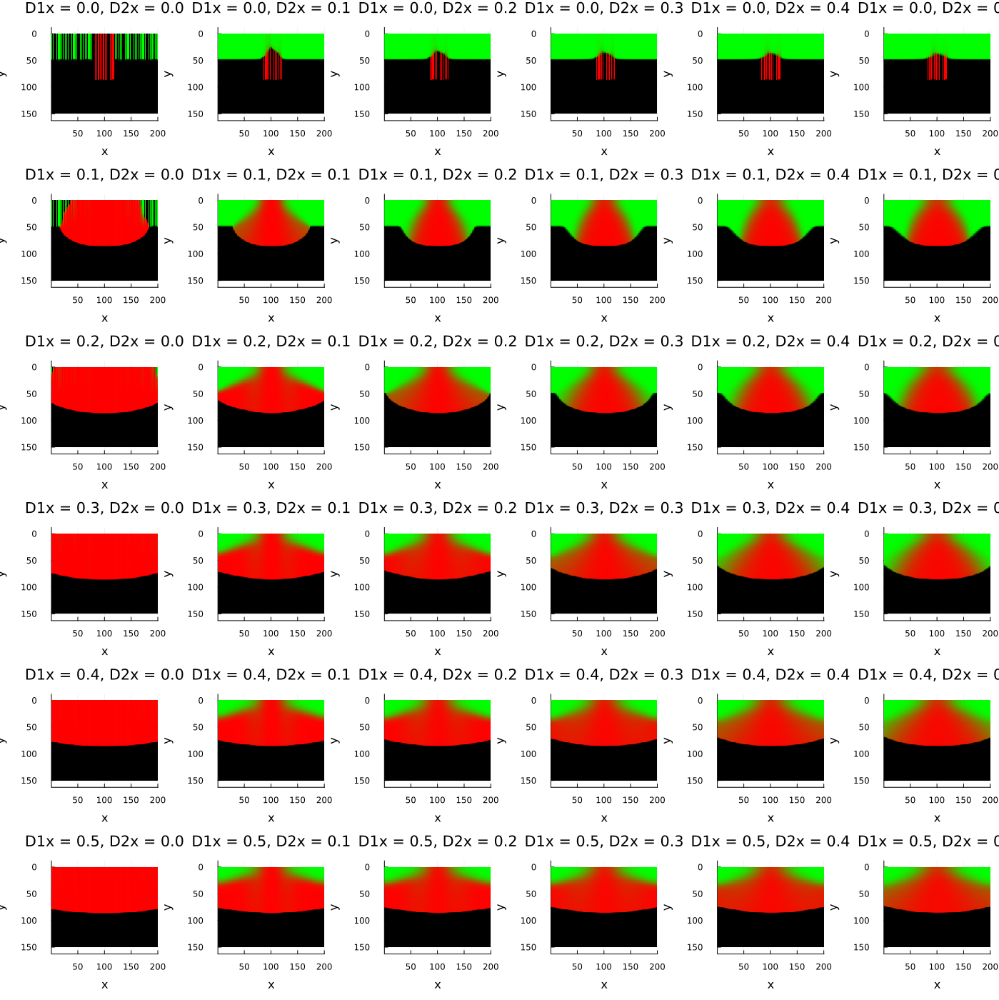

In [9]:
using Colors
using Plots

# Define the lambda ranges to loop over
lambda1x_vals = 0.0:0.1:0.5  # Modify range as needed
lambda2x_vals = 0.0:0.1:0.5  # Modify range as needed

# Storage for final density plots
plots = []

# Loop through lambda1x and lambda2x
for λ1x in lambda1x_vals
    for λ2x in lambda2x_vals
        # Run the simulation for the current λ1x and λ2x pair
        @time sol = simulate_reaction_diffusion_3(D1x=λ1x, D2x=λ2x)

        # Calculate the fraction of type 1
        f1 = sol[1, :, :, end] ./ (sol[1, :, :, end] .+ sol[2, :, :, end] .+ 1e-10)  # Avoid division by zero
        
        # Calculate the total density
        total_density = sol[1, :, :, end] .+ sol[2, :, :, end]

        # Create the colormap
        colormap = create_colormap(f1, total_density)

        # Generate the heatmap for this pair of λ1x and λ2x
        p = heatmap(colormap, title="D1x = $λ1x, D2x = $λ2x", xlabel="x", ylabel="y", color=:auto)

        # Store the plot in the array
        push!(plots, p)
    end
end

# Display the grid of plots
plot(plots..., layout=(length(lambda1x_vals), length(lambda2x_vals)), size=(1400, 1400))
